In [ ]:
# https://www.kaggle.com/jahirmorenoa/getting-the-structure-of-traffic-network

In [3]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

/kaggle/input/mock-traffic-data/MockTrafficDataForMCNFP.csv


In [4]:
traffic_df = pd.read_csv('/kaggle/input/mock-traffic-data/MockTrafficDataForMCNFP.csv')
# Make the columns that are dates into actual dates so you can do arithmetic on them
traffic_df = traffic_df.set_index('id')
cols = ['time_node_1', 'time_node_2', 'time_node_3','time_node_4', 'time_node_5', 'time_node_6']

for col in cols:
    traffic_df[col] = pd.to_datetime(traffic_df[col]).dt.time

traffic_df.head()

,plate_id,time_node_1,time_node_2,time_node_3,time_node_4,time_node_5,time_node_6
id,,,,,,,
0,1N6AD0C,07:00:03,07:11:02,NaT,07:42:11,NaT,08:44:01
1,KNDMG4C,07:00:05,NaT,07:47:46,NaT,08:43:54,09:12:38
2,5LMJJ3J,07:00:08,07:08:12,NaT,NaT,08:15:32,08:42:42
3,WAUDF78,07:00:12,NaT,07:47:53,NaT,08:44:54,09:13:59
4,1FAHP3E,07:00:56,NaT,07:52:36,NaT,08:54:49,09:25:31


## Showing a directed Graph of the tolls and how many times a path is travel all the 1500 samples in the dataset

In [24]:
path_nodes = [re.findall('\d', traffic_df.iloc[i].dropna().index[1:][j])[0] for i in range(len(traffic_df)) for j in range(len(traffic_df.iloc[i].dropna().index[1:]))]

In [8]:
for i in range(len(traffic_df)): # 1~1500 row
    for j in range(len(traffic_df.iloc[i].dropna().index[1:])): # 모든 행에 대해서 na 가 아닌 값을 남김. ex. 2행에 대해선 node 1,3,5,6 이 남음. 이것의 range는 4
        print(re.findall('\d', traffic_df.iloc[i].dropna().index[1:][j])[0] )
        path_nodes = re.findall('\d', traffic_df.iloc[i].dropna().index[1:][j])[0] # 정규표현식 re.findall('\d'=숫자 찾기) 을 통해서 time_node_n에서 n 값을 찾음. ex. 1행 : 1,2,4,6

1
2
4
6
1
3
5
6
1
2
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
4
6
1
2
5
6
1
2
4
5
6
1
3
5
6
1
3
5
6
1
3
4
5
6
1
3
4
6
1
3
4
5
6
1
2
4
5
6
1
3
5
6
1
2
4
5
6
1
2
4
6
1
2
4
5
6
1
3
4
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
2
5
6
1
3
5
6
1
3
4
6
1
3
5
6
1
2
4
5
6
1
2
4
6
1
2
5
6
1
2
4
6
1
2
4
6
1
3
5
6
1
2
4
5
6
1
2
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
3
5
6
1
2
4
6
1
3
4
5
6
1
2
5
6
1
2
4
5
6
1
2
4
6
1
2
4
6
1
3
5
6
1
2
4
5
6
1
3
5
6
1
2
4
6
1
2
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
2
4
6
1
3
4
6
1
2
4
6
1
2
4
6
1
3
4
5
6
1
2
4
6
1
2
4
6
1
2
4
6
1
3
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
3
5
6
1
2
4
6
1
3
4
6
1
3
4
5
6
1
2
4
5
6
1
3
5
6
1
3
5
6
1
2
5
6
1
2
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
2
4
6
1
2
4
5
6
1
3
5
6
1
3
5
6
1
2
4
5
6
1
3
5
6
1
3
5
6
1
3
4
6
1
3
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
2
4
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
2
4
6
1
2
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
3
4
6
1
2
4
6
1
2
4
6
1
2
4
5
6
1
3
4
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
2
4
6
1
2
4
6
1
3
5
6
1
3
5
6
1
2
4
5
6
1
2
4
5
6
1
2
4
6
1
3


6
1
2
5
6
1
3
5
6
1
3
4
5
6
1
2
4
6
1
3
5
6
1
2
4
6
1
2
4
5
6
1
2
4
5
6
1
3
5
6
1
2
4
6
1
3
5
6
1
2
4
6
1
2
4
5
6
1
2
4
5
6
1
3
5
6
1
3
5
6
1
2
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
2
5
6
1
2
4
6
1
3
5
6
1
2
4
6
1
2
4
6
1
2
4
6
1
2
4
5
6
1
2
4
6
1
2
4
6
1
3
4
5
6
1
2
4
6
1
2
4
6
1
2
4
5
6
1
2
4
5
6
1
2
4
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
3
4
5
6
1
3
5
6
1
3
5
6
1
2
4
6
1
3
5
6
1
3
4
5
6
1
2
4
6
1
2
4
5
6
1
3
5
6
1
2
4
6
1
2
4
5
6
1
3
4
5
6
1
2
4
5
6
1
3
5
6
1
2
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
2
4
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
2
4
5
6
1
3
5
6
1
2
4
6
1
3
4
6
1
3
5
6
1
3
5
6
1
3
4
6
1
3
5
6
1
2
4
5
6
1
2
4
6
1
3
5
6
1
2
5
6
1
3
5
6
1
2
4
6
1
3
4
5
6
1
2
4
5
6
1
2
4
5
6
1
2
4
6
1
3
4
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
5
6
1
3
4
5
6
1
3
5
6
1
2
4
6
1
2
4
6
1
3
4
6
1
3
4
6
1
3
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
2
4
6
1
3
5
6
1
3
5
6
1
2
4
5
6
1
2
4
6
1
3
4
6
1
3
4
6
1
2
4
6
1
3
4
5
6
1
3
5
6
1
2
4
6
1
2
4
5
6
1
2
4
6
1
2
4
6
1
2
5
6
1
3
5
6
1
2
4
5
6
1
3
5
6
1
2
4
6
1
3
5
6
1
2
4
6
1
2
4
6


In [9]:
path_nodes = [re.findall('\d', traffic_df.iloc[i].dropna().index[1:][j])[0] for i in range(len(traffic_df)) for j in range(len(traffic_df.iloc[i].dropna().index[1:]))]

# traffic_df 에서 보면 단순히 노드 1에서 6으로 갈수록 시간이 늘어나고 한 방향으로 흘러감.
# 그래서 단순히 한 행에서 1,3,5 가 있으면 1->3 , 3->5 로 쪼갬.
# [('1', '2'),('2', '4'),('4', '6'),('1', '3'),('3', '5'),('5', '6'),('1', '2'), ... ]
path_edges = [(path_nodes[i], path_nodes[i+1]) for i in range(len(path_nodes)-1) if path_nodes[i]!='6']

# 위에서 구한 것들을 set 해서 개수를 셈. 
cars_per_edge = [path_edges.count(i) for i in set(path_edges)]

In [16]:
path_nodes

['1',
 '2',
 '4',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '2',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '4',
 '6',
 '1',
 '2',
 '5',
 '6',
 '1',
 '2',
 '4',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '4',
 '5',
 '6',
 '1',
 '3',
 '4',
 '6',
 '1',
 '3',
 '4',
 '5',
 '6',
 '1',
 '2',
 '4',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '2',
 '4',
 '5',
 '6',
 '1',
 '2',
 '4',
 '6',
 '1',
 '2',
 '4',
 '5',
 '6',
 '1',
 '3',
 '4',
 '5',
 '6',
 '1',
 '2',
 '4',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '2',
 '4',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '2',
 '5',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '3',
 '4',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '2',
 '4',
 '5',
 '6',
 '1',
 '2',
 '4',
 '6',
 '1',
 '2',
 '5',
 '6',
 '1',
 '2',
 '4',
 '6',
 '1',
 '2',
 '4',
 '6',
 '1',
 '3',
 '5',
 '6',
 '1',
 '2',
 '4',
 '5',
 '6',
 '1',
 '2'

In [15]:
path =[]
path_travel=[]
for i in path_nodes:
    if i!='6':
        path.append(i)
    
    # i = 6 이라면 종점이므로, 다음 path_nodes는 시작점으로 간주한다.
    # 최종적으로, 시작점과 종점을 한 묶음으로 path_travel을 구성한다.
    else:
        path.append(i)
        print(path)
        path_travel.append(tuple(path))
        print(path_travel)
        path = []
        



['1', '2', '4', '6']
[('1', '2', '4', '6')]
['1', '3', '5', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6')]
['1', '2', '5', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6')]
['1', '3', '5', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6')]
['1', '3', '5', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6')]
['1', '3', '5', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6')]
['1', '3', '4', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6')]
['1', '2', '5', '6']
[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '2', '5', '6')]
['1', '2', '4', '5', '6']
[('1',

[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3

[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3

[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3

[('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '5', '6'), ('1', '3', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '2', '5', '6'), ('1', '3', '5', '6'), ('1', '3', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '2', '4', '5', '6'), ('1', '2', '5', '6'), ('1', '2', '4', '6'), ('1', '3', '5', '6'), ('1', '3', '5', '6'), ('1', '3

In [7]:
import re
import networkx as nx

def get_graph(traffic_df):
    
    # 리스트 내포
    # 정규표현식 (re.findall) 을 통해서 각 행의 na가 아닌 time_node_n에서 n 값을 찾음. ex. 1행 : 1,2,4,6 ~ 1500행 까지.
    path_nodes = [re.findall('\d', traffic_df.iloc[i].dropna().index[1:][j])[0] for i in range(len(traffic_df)) for j in range(len(traffic_df.iloc[i].dropna().index[1:]))]
    
    # 앞선 
    path_edges = [(path_nodes[i], path_nodes[i+1]) for i in range(len(path_nodes)-1) if path_nodes[i]!='6']
    
    cars_per_edge = [path_edges.count(i) for i in set(path_edges)]
        
    edges = list(set(path_edges))
    
    path =[]
    path_travel=[]
    for i in path_nodes:
        if i!='6':
            # i != 6, 시작점
            path.append(i)
        else:
            # i =6 : 종점 
            # 최종 생성물 : 이동 경로 1row : 1->2->4->6
            path.append(i)
            path_travel.append(tuple(path))
            path = []
    
    G = nx.DiGraph()
    
    for edge, weight in zip(edges, cars_per_edge):
        G.add_edges_from([edge], num_cars=weight)
    return G, path_travel, path_edges

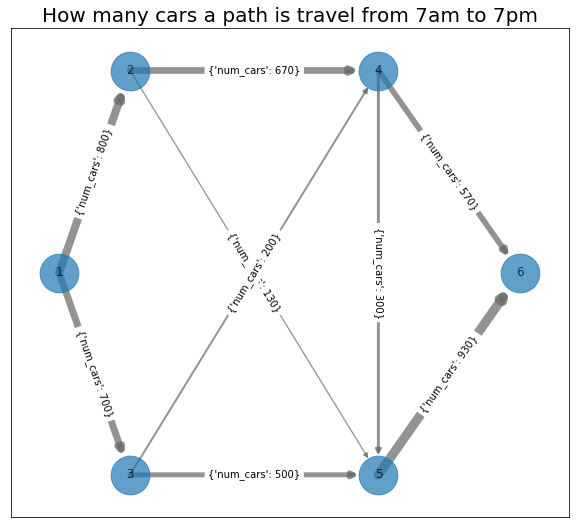

In [26]:
import matplotlib.pyplot as plt

%matplotlib inline
plt.figure(figsize=(10,9))

G, path_travel, path_edges = get_graph(traffic_df)

edge_width = [0.01*G[u][v]['num_cars'] for u,v in G.edges()]

# pos = {'1':(-0.6,0), '2':(-0.4,0.4), '3':(-0.4, -0.4), '4':(0.3,0.4), '5':(0.3, -0.4), '6':(0.7, 0)}
nx.draw_networkx(G, pos=pos, alpha=0.7, width=edge_width, node_size=1500, edge_color='.4', cmap=plt.cm.Blues)
labels = nx.draw_networkx_edge_labels(G, pos=pos, font_size=10)
plt.title('How many cars a path is travel from 7am to 7pm', size=20)
plt.show()

## Let's see which path are the best for traveling faster from node1 to node6

In [22]:
from datetime import timedelta
end_time = [timedelta(hours=x.hour, minutes=x.minute, seconds=x.second) for x in traffic_df['time_node_6']]
start_time = [timedelta(hours=x.hour, minutes=x.minute, seconds=x.second) for x in traffic_df['time_node_1']]

eda_traffic = traffic_df.copy()
eda_traffic['avg_time_travel'] = np.array(end_time) - np.array(start_time)
eda_traffic['path_travel'] = path_travel
time_travel_paths = pd.DataFrame(eda_traffic.groupby(by='path_travel')['avg_time_travel'].agg(lambda x: x.mean()))


## Ranking of path of nodes travel through them

In [23]:
ranking_time_travel_nodes = time_travel_paths.reset_index()
ranking_time_travel_nodes

,path_travel,avg_time_travel
0,"(1, 2, 4, 5, 6)",01:39:48.385000
1,"(1, 2, 4, 6)",01:39:25.912765
2,"(1, 2, 5, 6)",01:51:29.023076
3,"(1, 3, 4, 5, 6)",02:02:41.620000
4,"(1, 3, 4, 6)",02:00:33.920000
5,"(1, 3, 5, 6)",02:19:28.654000


## Nodes in which most cars pass through them

In [24]:
ranking_time_travel_nodes.iloc[0]['path_travel']

('1', '2', '4', '5', '6')

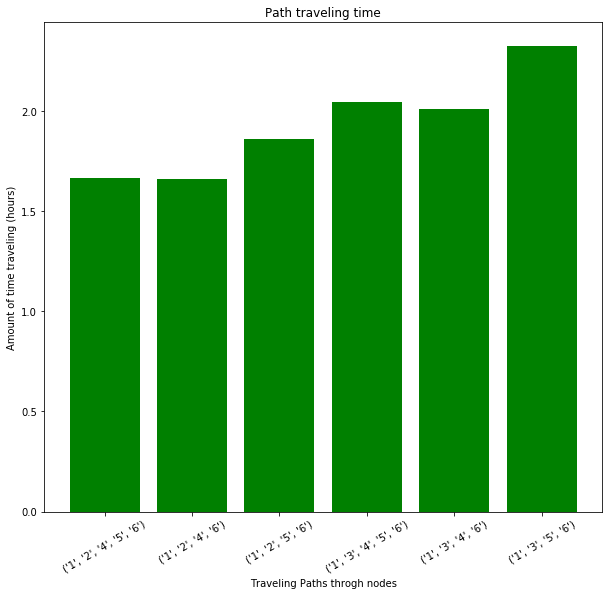

In [25]:
time_travel_paths['avg_time_travel'] = time_travel_paths['avg_time_travel'].apply(lambda x : x.total_seconds()/3600)
plt.figure(figsize=(10,9))
r_bins = range(len(time_travel_paths))
plt.bar(r_bins, time_travel_paths['avg_time_travel'], color='g')
plt.xticks(r_bins, list(time_travel_paths.index), rotation=30)
plt.yticks()
plt.xlabel('Traveling Paths throgh nodes')
plt.ylabel('Amount of time traveling (hours)')
plt.title('Path traveling time')
plt.show()